In [1]:
!pip install skimpy

  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.2/117.2 kB 6.1 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: typeguard
    Found existing installation: typeguard 4.3.0
    Uninstalling typeguard-4.3.0:
      Successfully uninstalled typeguard-4.3.0
  Attempting uninstall: ipykernel
    Found existing installation: ipykernel 5.5.6
    Uninstalling ipykernel-5.5.6:
      Successfully uninstalled ipykernel-5.5.6
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires ipykernel==5.5.6, but you have ipykernel 6.29.5 which is incompatible.


In [2]:
!pip install summarytools

# Let's Cluster some Credit Cards!
In this notebook we will try to cluster some credit cards. We will go through preprocessing, choose a model and train it on our data, and then evaluate our outcomes.

# Libraries

In [4]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
import pandas as pd
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from summarytools import dfSummary
from skimpy import skim
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [5]:
df = pd.read_csv('Credit Card Dataset.csv')

# EDA
Explore the Dataset Perform initial exploration of your dataset. Understand the features and the distribution of data.

In [6]:
skim(df)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 8950   │ │ float64     │ 14    │                                                          │
│ │ Number of columns │ 18     │ │ int64       │ 3     │                                                          │
│ └───────────────────┴────────┘ │ string      │ 1     │                                                          │
│                                └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━┳━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━━┓  │
│ ┃ column_name         ┃ NA  ┃ NA % ┃ mean   ┃ sd     ┃ p0      ┃ p25     ┃ p50     ┃ p75    ┃ p100  ┃ hist   ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━╇━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━━┩  │
│ │ BALANCE             │   0 │    0 │   1564 │   2082 │       0 │   128.3 │   873.4 │   2054 │ 19040 │   ▇▁   │  │
│ │ BALANCE_FREQUENCY   │   0 │    0 │ 0.8773 │ 0.2369 │       0 │  0.8889 │       1 │      1 │     1 │    ▁▁▇ │  │
│ │ PURCHASES           │   0 │    0 │   1003 │   2137 │       0 │   39.63 │   361.3 │   1110 │ 49040 │   ▇    │  │
│ │ ONEOFF_PURCHASES    │   0 │    0 │  592.4 │   1660 │       0 │       0 │      38 │  577.4 │ 40760 │   ▇    │  │
│ │ INSTALLMENTS_PURCHA │   0 │    0 │  411.1 │  904.3 │       0 │       0 │      89 │  468.6 │ 22500 │   ▇    │  │
│ │ SES                 │     │      │        │        │         │         │         │        │       │        │  │
│ │ CASH_ADVANCE        │   0 │    0 │  978.9 │   2097 │       0 │       0 │       0 │   1114 │ 47140 │   ▇    │  │
│ │ PURCHASES_FREQUENCY │   0 │    0 │ 0.4904 │ 0.4014 │       0 │ 0.08333 │     0.5 │ 0.9167 │     1 │ ▇▃▁▂▃▇ │  │
│ │ ONEOFF_PURCHASES_FR │   0 │    0 │ 0.2025 │ 0.2983 │       0 │       0 │ 0.08333 │    0.3 │     1 │ ▇▂ ▁▁▁ │  │
│ │ EQUENCY             │     │      │        │        │         │         │         │        │       │        │  │
│ │ PURCHASES_INSTALLME │   0 │    0 │ 0.3644 │ 0.3974 │       0 │       0 │  0.1667 │   0.75 │     1 │ ▇▂▁▁▂▃ │  │
│ │ NTS_FREQUENCY       │     │      │        │        │         │         │         │        │       │        │  │
│ │ CASH_ADVANCE_FREQUE │   0 │    0 │ 0.1351 │ 0.2001 │       0 │       0 │       0 │ 0.2222 │   1.5 │  ▇▂▁   │  │
│ │ NCY                 │     │      │        │        │         │         │         │        │       │        │  │
│ │ CASH_ADVANCE_TRX    │   0 │    0 │  3.249 │  6.825 │       0 │       0 │       0 │      4 │   123 │   ▇    │  │
│ │ PURCHASES_TRX       │   0 │    0 │  14.71 │  24.86 │       0 │       1 │       7 │     17 │   358 │   ▇    │  │
│ │ CREDIT_LIMIT        │   1 │ 0.01 │   4494 │   3639 │      50 │    1600 │    3000 │   6500 │ 30000 │  ▇▃▁   │  │
│ │ PAYMENTS            │   0 │    0 │   1733 │   2895 │       0 │   383.3 │   856.9 │   1901 │ 50720 │   ▇    │  │
│ │ MINIMUM_PAYMENTS    │ 313 │  3.5 │  864.2 │   2372 │ 0.01916 │   169.1 │   312.3 │  825.5 │ 76410 │   ▇    │  │
│ │ PRC_FULL_PAYMENT    │   0 │    0 │ 0.1537 │ 0.2925 │       0 │       0 │       0 │ 0.1429 │     1 │ ▇▁   ▁ │  │
│ │ TENURE              │   0 │    0 │  11.52 │  1.338 │       6 │      12 │      12 │     12 │    12 │      ▇ │  │
│ └─────────────────────┴─────┴──────┴────────┴────────┴

In [7]:
dfSummary(df)

No,Variable,Stats / Values,Freqs / (% of Valid),Graph,Missing
1,CUST_ID[object],1. C100012. C161353. C161294. C161305. C161316. C161327. C161338. C161349. C1613610. C1614411. other,"1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)1 (0.0%)8,940 (99.9%)","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAJsAAAD+CAYAAAAtWHdlAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjcuMSwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy/bCgiHAAAACXBIWXMAAA9hAAAPYQGoP6dpAAADLklEQVR4nO3cwY3TYBRG0ecogmFja2QpJUAPKYItvdOFNzCswoIeriVzTgX/4kpPkfxleb1eA4Xb2Q/g/yE2MmIjIzYyYiMjNjJiIyM2MmIjIzYyt2VZvi3L8nb2Q7i+28x8nZnPZz+E63NGyYiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI3MbWZ+zsyfsx/C9S3+xYiKM0pGbGSsq8hYV5FxRsmIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyBi8kDF4IeOMkhEbGYMXMgYvZJxRMmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyBi9kDF7IOKNkxEZGbGSsq8hYV5FxRsmIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyFhXkbGuIuOMkhEbGYMXMgYvZJxRMmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyBi9kDF7IOKNkxEbG4IWMwQsZZ5SM2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyFhXkbGuIuOMkhEbGesqMtZVZJxRMmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyBi9kDF7IOKNkxEbG4IWMwQsZZ5SM2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzBCxmDFzLOKBmxkREbGesqMtZVZJxRMmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYy1lVkrKvIOKNkxEbG4IWMwQsZZ5SM2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzBCxmDFzLOKJllZr7MzKezH8L13fd9/76u6/vZD+H67uu6vj+fz9/btn2c/Riu6ziOt/vMzLZtH4/H49fZD+La/EAgIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjc5/59/nH2Q/h2o7jeFv2ff/h40kKPgsnY11Fxg8EMmIjIzYyYiMjNjJiIyM2MmIjIzYyfwFj50uCzHpkKgAAAABJRU5ErkJggg=="">",0(0.0%)
2,BALANCE[float64],Mean (sd) : 1564.5 (2081.5)min < med < max:0.0 < 873.4 < 19043.1IQR (CV) : 1925.9 (0.8),"8,871 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjcuMSwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy/bCgiHAAAACXBIWXMAAA9hAAAPYQGoP6dpAAACI0lEQVR4nO3ZwYraUBSH8XOqI3GEBHGIOx+hC5c+RB92tl0KeRghaIKZWCXcrqab0jreaOvf+X5r7+EiHzfkxkMIBty7L/97A8BHDM/9wN3HZjaKnH8MIbSRa4Ff/hqqu49ns9m3NE2nMcPrut66+yuxoq9zJ+ooTdPparVqsyw7XDK4qqqkKIppWZYjMyNU9HL20W9mlmXZIc/zt4j544g1wG94mYIEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoWE4S2Hd133ZGapu8eOOIYQ2ituCaJuFmrTNE+n0+nrYrEYDAaDQ8yMuq637v5KrLhZqMfjcZgkyfNyuTzM5/PtpeurqkqKopiWZTkyM0L95G766Dczm0wmhzzP3yKXj6+6GcjiZQoSCBUSCBUSCBUSbv4y1UfPe1juYB/I3Yba9x6WO9jHcreh9rmH5Q728dxtqO9i72G7rkuNz7cP4+5DjcHn28fzkKFe4/Pter3Oy7J8cfc6ZgsEfl0fCrWqquTSwfv9PjEza5om2Ww2z/9y/fvaWG3b9jqRd7vd3t2/m1nUaf5J/Qgh/PH/+gkbZsaaNIc/cgAAAABJRU5ErkJggg=="">",0(0.0%)
3,BALANCE_FREQUENCY[float64],Mean (sd) : 0.9 (0.2)min < med < max:0.0 < 1.0 < 1.0IQR (CV) : 0.1 (3.7),43 distinct values,"<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjcuMSwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy/bCgiHAAAACXBIWXMAAA9hAAAPYQGoP6dpAAACXUlEQVR4nO3XsW7aUBiG4f/QBAwFGzAxF9ABiWxIWbiAjrnYXkIGhq5l6MJQsSEQMoUEFQwdmkhdEmobAl/1Piv55KOcVxa4/X5vwKUrnPsAwL+4OvcB8P9wzpXNrJhx/mu/3z+99iGh4iicc+UwDO99329k2S8Wi7lz7strsRIqjqXo+36j3+8/BUGwTjOM49gbDAaN2WxWNDNCxekFQbCOougxw7T81of8mIIEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoUEQoWEq3MfAJfDOVc2s2LGub/b7a6PeZ6/ESrM7E+kYRje+77fyLLfbDZekiS36/X6wcwej3w8Qj2FnG+mgpntcjw+696vVqtRv99fBEGwTjsej8eN4XBY2W63HzI8+6CThprzwszyXdq5LtxrNpufgyD4mHaYJMn1arX6VK1WR4VCYfOe+5c3YqlUeoiiKPUbcT6fl9Nu0jgYao7YMl+YWb5/+rkv3Mxu7+7uvrZarUWa7fNb6abX631vt9vzVIfOuT/1GzGvN0PN873l5cK63e63Wq32M+1+Op16o9HoptPp/KjX68v32h7p2ZUkSS7ywg9ZrVbeZDKppN0tl0sv6z6OY+/Q3/wGd8zJaWZBblkAAAAASUVORK5CYII="">",0(0.0%)
4,PURCHASES[float64],Mean (sd) : 1003.2 (2136.6)min < med < max:0.0 < 361.3 < 49039.6IQR (CV) : 1070.5 (0

In [ ]:
df.CUST_ID.value_counts().plot(kind='bar')

In [8]:
df = df.drop('CUST_ID', axis=1)

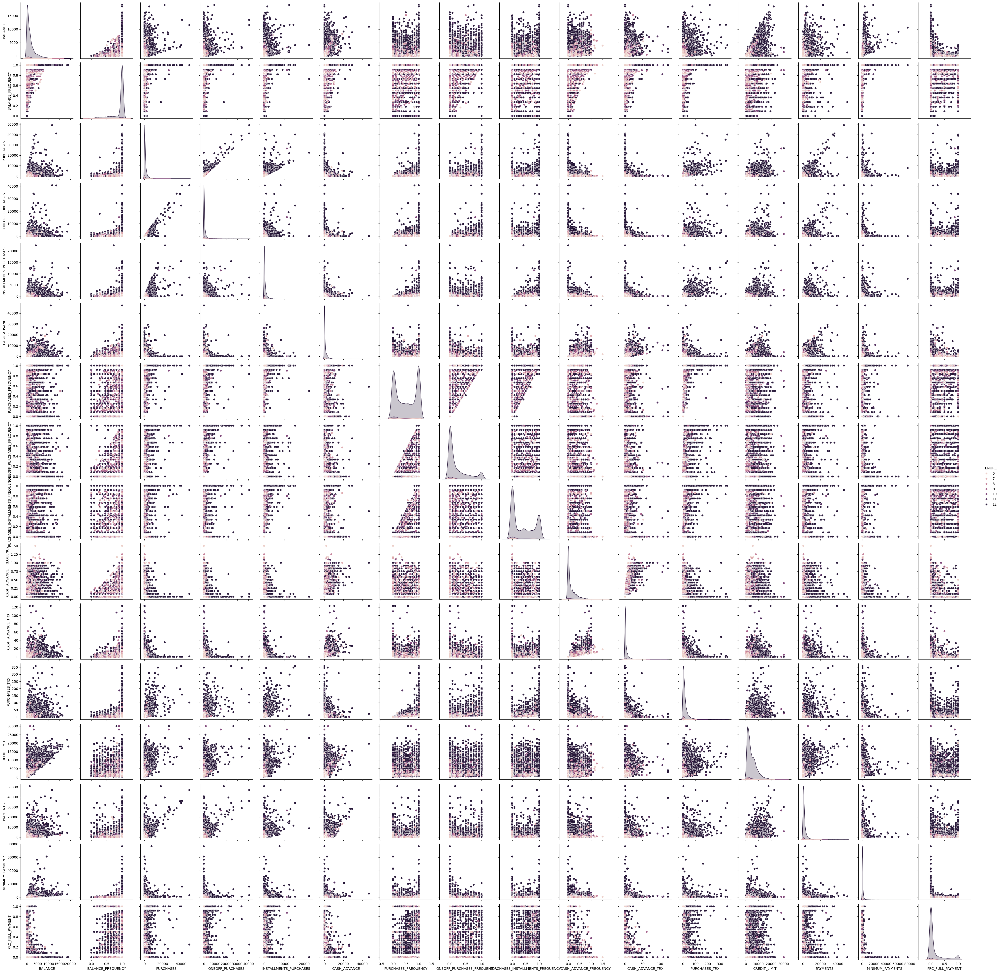

In [9]:
sns.pairplot(df, hue='TENURE')

# Preprocessing
1. Remove the outliers
2. Impute missing data
3. Scale the data
4. Reduce dimentions using PCA

In [10]:
null_im = IterativeImputer(max_iter=10, random_state=0)
df_filled = null_im.fit_transform(df)

In [11]:
df = pd.DataFrame(df_filled, columns=df.columns)

In [12]:
df.isnull().sum()

,0
BALANCE,0
BALANCE_FREQUENCY,0
PURCHASES,0
ONEOFF_PURCHASES,0
INSTALLMENTS_PURCHASES,0
CASH_ADVANCE,0
PURCHASES_FREQUENCY,0
ONEOFF_PURCHASES_FREQUENCY,0
PURCHASES_INSTALLMENTS_FREQUENCY,0
CASH_ADVANCE_FREQUENCY,0


In [13]:
sns.pairplot(df, hue='TENURE')

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x79ef7526c670> (for post_execute):


KeyboardInterrupt: 

{'whiskers': [<matplotlib.lines.Line2D at 0x79ef05674be0>,
 'caps': [<matplotlib.lines.Line2D at 0x79ef05675120>,
 'boxes': [<matplotlib.lines.Line2D at 0x79ef05674940>,
 'medians': [<matplotlib.lines.Line2D at 0x79ef05675660>,
 'fliers': [<matplotlib.lines.Line2D at 0x79ef05675900>,
 'means': []}

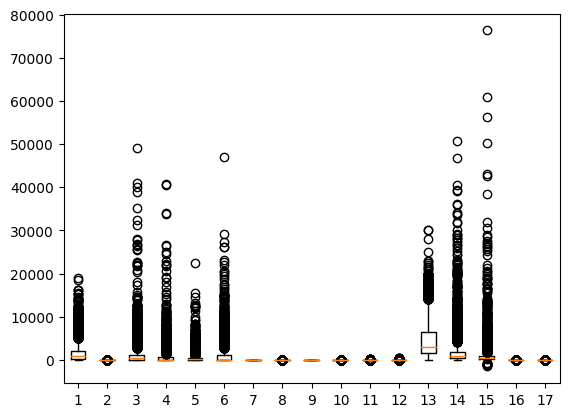

In [15]:
plt.boxplot(df)

In [16]:
from sklearn.ensemble import IsolationForest
iso = IsolationForest(contamination=0.2)
df['outlier'] = iso.fit_predict(df)
df['outlier'] = df['outlier'].map({1: 'Inlier', -1: 'Outlier'})

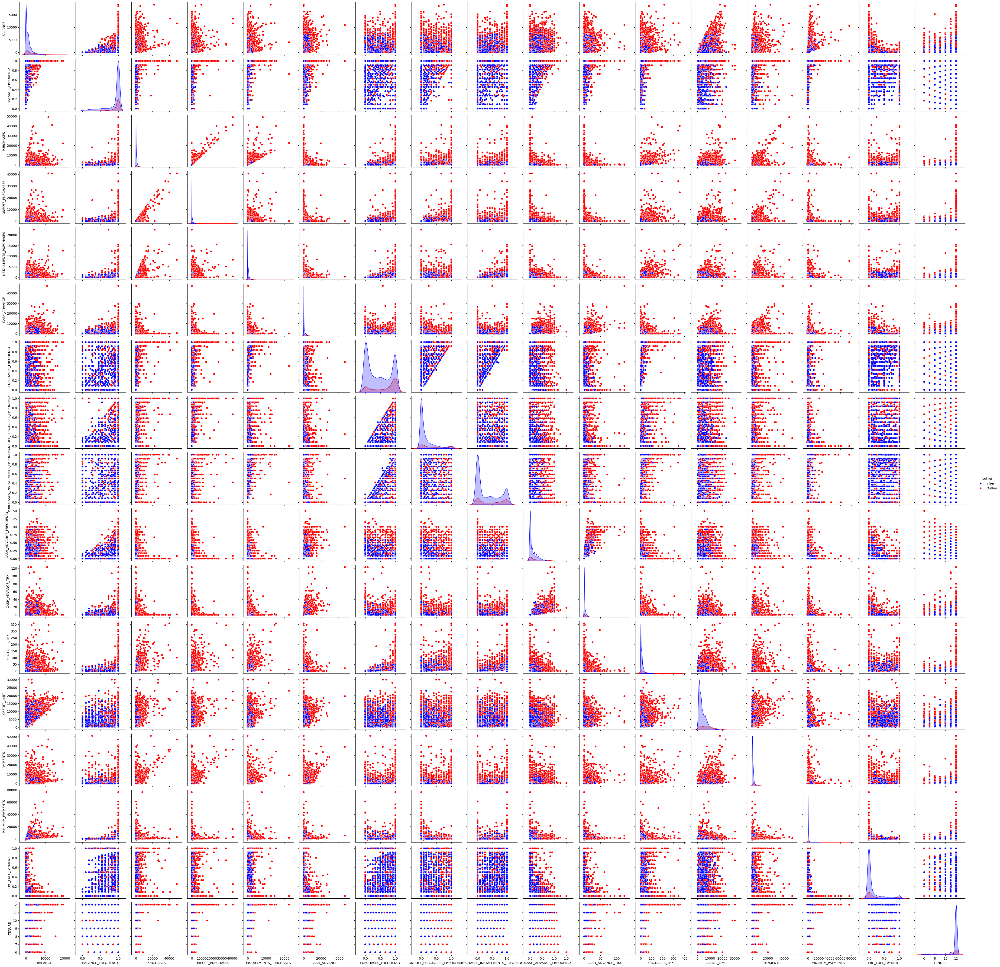

In [17]:
sns.pairplot(df, hue='outlier', palette={'Inlier': 'blue', 'Outlier': 'red'})
plt.show()

In [18]:
df['outlier'].value_counts()

,count
outlier,
Inlier,7160
Outlier,1790


In [33]:
df_no_outliers_IF = df[df['outlier'] == 'Inlier'].drop(columns=['outlier', 'Outlier'])

{'whiskers': [<matplotlib.lines.Line2D at 0x79ef150a31f0>,
 'caps': [<matplotlib.lines.Line2D at 0x79ef150a2fb0>,
 'boxes': [<matplotlib.lines.Line2D at 0x79ef150a0790>,
 'medians': [<matplotlib.lines.Line2D at 0x79ef150a3d00>,
 'fliers': [<matplotlib.lines.Line2D at 0x79ef150a3580>,
 'means': []}

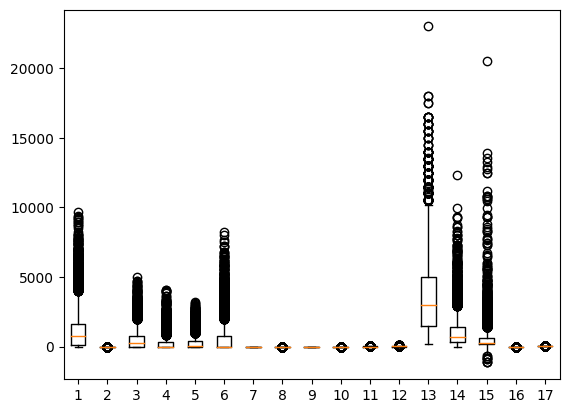

In [34]:
plt.boxplot(df_no_outliers_IF)

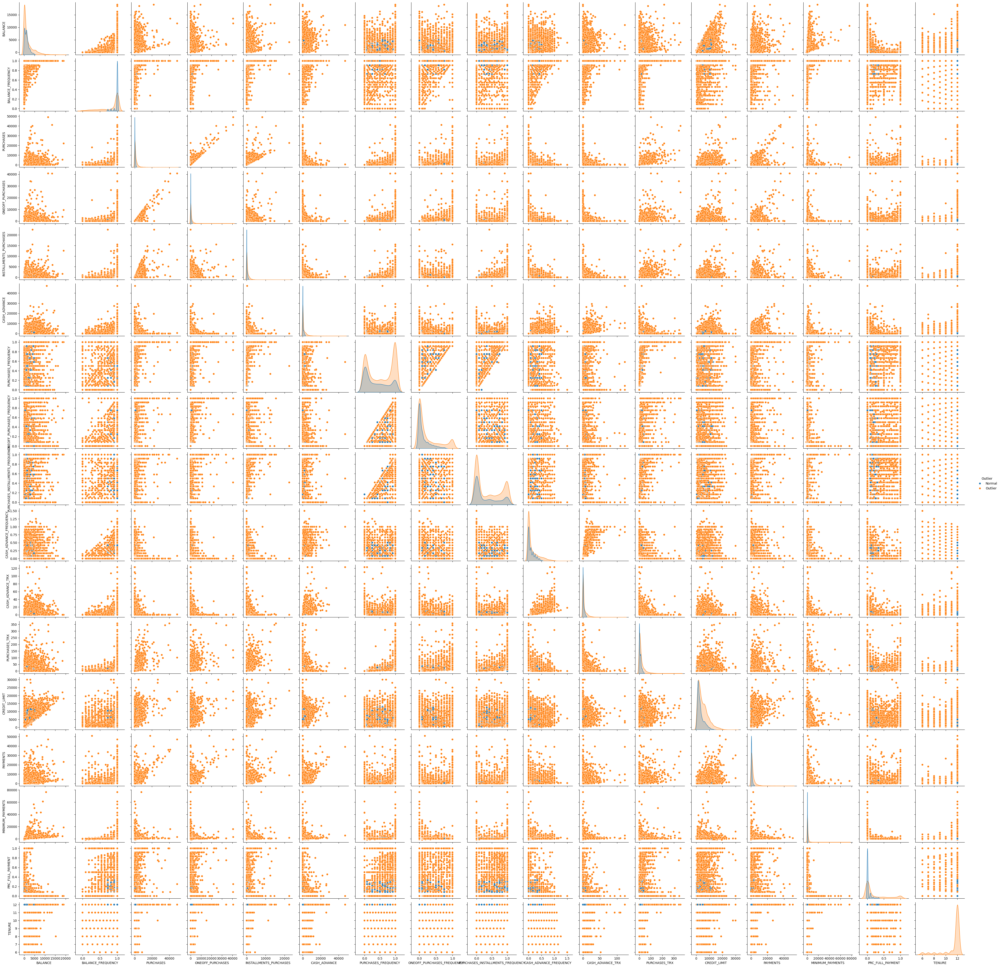

In [19]:
import seaborn as sns
import pandas as pd

def mark_outliers_all_columns(df):
    outlier_flags = pd.DataFrame(index=df.index)

    for column in df.select_dtypes(include='number').columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        outlier_flags[column] = ((df[column] < lower_bound) | (df[column] > upper_bound)).astype(int)

    # Combine all column outlier flags into one
    df['Outlier'] = outlier_flags.sum(axis=1).apply(lambda x: 'Outlier' if x > 0 else 'Normal')
    return df

# Assuming df is your DataFrame
df = mark_outliers_all_columns(df)

# Plotting the pairplot with the outliers marked
sns.pairplot(df, hue='Outlier')

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 19 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   BALANCE                           8950 non-null   float64
 1   BALANCE_FREQUENCY                 8950 non-null   float64
 2   PURCHASES                         8950 non-null   float64
 3   ONEOFF_PURCHASES                  8950 non-null   float64
 4   INSTALLMENTS_PURCHASES            8950 non-null   float64
 5   CASH_ADVANCE                      8950 non-null   float64
 6   PURCHASES_FREQUENCY               8950 non-null   float64
 7   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 8   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 9   CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 10  CASH_ADVANCE_TRX                  8950 non-null   float64
 11  PURCHASES_TRX                     8950 non-null   float64
 12  CREDIT

In [21]:
df['Outlier'].value_counts()

,count
Outlier,
Outlier,5963
Normal,2987


In [35]:
df_no_outliers_IQR = df[df['Outlier'] == 'Normal'].drop(columns=['outlier', 'Outlier'])

{'whiskers': [<matplotlib.lines.Line2D at 0x79ef14a5c640>,
 'caps': [<matplotlib.lines.Line2D at 0x79ef14a5c5b0>,
 'boxes': [<matplotlib.lines.Line2D at 0x79ef14a5e230>,
 'medians': [<matplotlib.lines.Line2D at 0x79ef14a5dfc0>,
 'fliers': [<matplotlib.lines.Line2D at 0x79ef0d2a02e0>,
 'means': []}

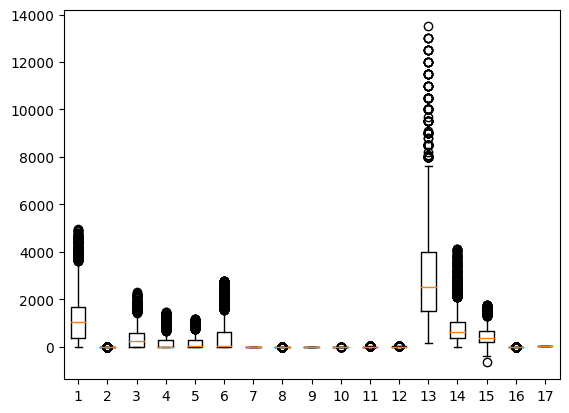

In [36]:
plt.boxplot(df_no_outliers_IQR)

In [37]:
dfSummary(df_no_outliers_IQR)

No,Variable,Stats / Values,Freqs / (% of Valid),Graph,Missing
1,BALANCE[float64],Mean (sd) : 1198.5 (1021.2)min < med < max:1.2 < 1034.3 < 4940.1IQR (CV) : 1294.0 (1.2),"2,987 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjcuMSwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy/bCgiHAAAACXBIWXMAAA9hAAAPYQGoP6dpAAACsklEQVR4nO3bu47aQBSA4TPhEgOKAbGCzi1FpBSUNHmDPGzadEGCHvEGNAgJGRAOBHNJkexqpbBcxniZY/1fzRgXv0D2nDHH41EA13149A0A18hf+oAxpiQiRcvrb4/H49pyLfDibKjGmFKj0fjm+37d5uLL5TI0xnwnViR16Re16Pt+vdvtrqvV6uaWCy8WC6/f79dns1lRRAgViVz86xcRqVarm2az+cvi+iWLNcB/eJiCCoQKFQgVKhAqVCBUqECoUIFQoQKhQgVChQqEChUIFSoQKlQgVKhAqFDhqjG/R+F0AZ45GyqnC/Cas6EKpwvwisuhiginC/AXD1NQgVChAqFCBUKFCoQKFQgVKqT6emq/3xdExDfG2Cz3D4dD4c63BKVSCzWKokIcx1+CIMjlcrmbXtiLiMRx7O33+8+bzeaniNi8R0WGpBbqdrvNe55X7nQ6m1arFd66fjwe10ejUXm32+XSuD/okvrOVKVSsdpZCsOQnSW84GEKKhAqVCBUqECoUIFQoQKhQgVChQqEChUIFSo4f2bKVsKBGBGOWzslk6EmHYgR4bi1azIZatKBGI5buyeToT6zHYj5h6EYh/AwBRUIFSoQKlQgVKhAqFCBUKECoUIFQoUKhAoVMr0zlUTCoRYGWu6MUE9IOtQyn89XxpgfImIzEEPkJxDqCUmGWiaTyafBYPA1CIInm8iZ2jqNUM+wGWoJw7BkGzlTW28j1JQkmNxiausEnvqhAqFCBf76HcNZr9MI1SGc9XoboTrkHme9er1eczabPRljlja34GrghOog2zcGD96oEEkxdELNkEduVIikuyNHqBn03hsVIunvyF0V6mKx8G794tVq5YmIRFHkTafT8nuu1/rdLty3rTiO857nldvttqnVar9vWbterz8Oh8OzO3J/ADxZkXXT+v6vAAAAAElFTkSuQmCC"">",0(0.0%)
2,BALANCE_FREQUENCY[float64],1. 1.02. 0.9090913. 0.8181824. 0.727273,"2,621 (87.7%)143 (4.8%)122 (4.1%)101 (3.4%)","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAJsAAABcCAYAAAB5jMeAAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjcuMSwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy/bCgiHAAAACXBIWXMAAA9hAAAPYQGoP6dpAAAB6klEQVR4nO3bMW7iUBiF0ecRipLGFkJiMSwii51FeDcI4WISpXGKlMFQ5PclYs5ZgPWKTw8Z+XbzPDdI+HPvA/D/EBsxXWvtpbX2dO+D8Gt9zPP8VvGgzW63e+37flvxMB7PNE2nruv+VgS36ft+ezgc3oZheK84HI/jfD4/j+O4PR6PT621n8fWWmvDMLzv9/t/Pz4dj+il6kFeEIgRGzFiI0ZsxIiNGLERIzZixEaM2IgRGzFiI0ZsxIiNmE1rX5+S3Psg/D7VXWymaTqN47hthZ+S8DimaTq11j4qnuWzcG4p+yy8M+UjxQsCMbd+RsuuULi6rqpc1sDiuqp6WQO31lX+DqGMFwRixEaM2IgRGzFiI0ZsxIiNGLERIzZixEaM2IgRGzFiI0ZsxCxO+cz7qHZ1ylc54wIbBGJM+Yi5drO51Si1uK6yrKLaxXWVZRVruLausqyilD91iREbMWIjRmzEiI0YsREjNmLERozYiBEbMWIjRmzEiI0YsRFzcV1lWcUaFtdVllVUs0EgxrqKmKWbza1GuYvrKssq1vBtXWVZxVqW1lWWVZTzpy4xYiNGbMSIjRixESM2YsRGjNiIERsxYiNGbMSIjRixESM2Yr6tqyyrWMvFdZVlFWuwQSDGuooYLwjEfAI/I9i5UdFknwAAAABJRU5ErkJggg=="">",0(0.0%)
3,PURCHASES[float64],Mean (sd) : 376.4 (443.8)min < med < max:0.0 < 220.0 < 2315.9IQR (CV) : 575.1 (0.8),"1,968 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjcuMSwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy/bCgiHAAAACXBIWXMAAA9hAAAPYQGoP6dpAAACiklEQVR4nO3du47aQBSA4TOwIHORbcQGOjdbuEtBSZM3yMOmTYlEzwNQpEWYtRHeJSDHaUIUKdKCx3jXx/q/mhkofnwZWxqT57kAddf66B8A3OLh2geMMT0R6VrOf8rz/NVyLPDXm6EaY3rj8fir67ojm8n3+/2zMeYbsaKsa0fUruu6o/l8/up53rHIxEmSOMvlchRFUVdECBWlXD31i4h4nnecTCYvFvP3LMYA/+FmCioQKlQgVKhAqFCBUKECoUIFQoUKhAoVCBUqECpUIFSoQKhQgVChAqFCBUKFCoQKFQgVKhAqVCBUqECoUIFQoQKhQgVChQqEChUIFSoQKlQgVKhAqFCBUKECoUIFQoUKhAoVCBUqECpUIFSoQKhQgVChAqFCBUKFCoQKFQgVKty0c5+tLMs6IuIaY2ynYNNfiEiFoaZp2jmfz5+DIGi32+1C+6hesOkvLioL9XQ6PTiO05/NZsfpdPpcdDyb/uJflZ76RUQGg4Hthr8ibPqLP7iZggqEChUqP/WXUXLVgBWDBqltqGVXDVgxaJbahlpm1YAVg+apbagXJVYNWDFoEG6moAKhQgVChQq1v0a1xQsxzdLIUHkhpnkaGeo9XohZLBaTKIoejTF7m59A4PfVyFAvbJe2eNhQP40O1VbZhw0cje+PUN9gc0TmaFwNQr0zHv1Wg1ArYnt9nGWZK+WW1Voi8stybG0vOwi1RspeNmRZ1knT9Gk4HK5brda56Pg4jg/GmO8iYrWkJxX+SW4KNUkSp+i3Hg4HR0QkTVNns9n033O81u/e7XZDx3H6YRga3/d/FhkrIrLdbp31ev0pDMMfvu8fioyN43i4Wq2+BEHw+BF/kmvX5r8B+9BctUhw94wAAAAASUVORK5CYII="">",0(0.0%)
4,ONEOFF_PURCHASES[float64],Mean (sd) : 199.8 (332.4)min < med < max:0.0 < 0.0 < 1443.3IQR (CV) : 270.0 (0.6),"1,218 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjcuMSwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy/bCgiHAAAACXBIWXMAAA9hAAAPYQGoP6dpAAACn0lEQVR4nO3YMW/aUBSG4XOBIJNQA0ribCwd2DowZu

In [38]:
dfSummary(df_no_outliers_IF)

No,Variable,Stats / Values,Freqs / (% of Valid),Graph,Missing
1,BALANCE[float64],Mean (sd) : 1181.8 (1456.8)min < med < max:0.0 < 733.4 < 9680.2IQR (CV) : 1558.0 (0.8),"7,090 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjcuMSwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy/bCgiHAAAACXBIWXMAAA9hAAAPYQGoP6dpAAACbklEQVR4nO3du47aQBiG4X84rMwhNogVdDQp6FJQ0uQOcrFpUyJBzQWkR0jWAsJZFstxioQoUg7AGLJ81vvUOwPFiy2vfmtcnucG3LvKa38B4By1U3/gnGuY2YPn/oc8z5891wI//TNU51yj1+t9CMOw67P5drt9cs59JFYUdeqK+hCGYXcymTxHUbS/ZOPNZhPMZrNuHMcPZkaoKOTkrd/MLIqifb/f/+Kxf8NjDfAbHqYggVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAhgVAh4azDJnxlWVY3s9A557sF51TBzG4YapIk9TRN3w2Hw2q1Wr3o6J8jzqnC0c1CPRwOtSAImuPxeD8YDJ4uXc85VfjVTW/9ZmatVsv3jCozzqnCDzxMQQKhQgKhQgKhQgKhQgKhQgKhQgKhQgKhQgKhQgKhQgKhQsLNh1KKKDjPyixridxtqEXnWZllLZe7DbXIPCuzrOVzt6EeFZhnZZa1RHiYggRChYS7v/X74g3YcillqLwBWz6lDPUab8BOp9N+HMePzrmtz1cg8OsqZahHvv8xKHpFXq/XO+fcJzPzuZoT+R+UOlRfRa7Iy+XyzXw+fz8cDh9fIXKz7w/IXz3X3u2P5KxQN5tNcOnGu90uMDNLkiRYrVbN/7n+Wp/tI03TWhAEzdFo5Dqdzssla9frdXuxWHhHnmVZPUmSt+12+3OlUkkvXX+FH0kRL3me//VzvwFAgAeuNwqUaQAAAABJRU5ErkJggg=="">",0(0.0%)
2,BALANCE_FREQUENCY[float64],Mean (sd) : 0.9 (0.2)min < med < max:0.0 < 1.0 < 1.0IQR (CV) : 0.1 (3.6),42 distinct values,"<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjcuMSwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy/bCgiHAAAACXBIWXMAAA9hAAAPYQGoP6dpAAACVklEQVR4nO3XsW7aUACF4XtpAja1rgET8wAdGCIxIGXhATrmYfsIGRg6M3RhqNgQCBnhhBYMHdpKXRJqG2pO9X8rOfgKfl0UezweDXDtalUfAPgbN1UfAP8Pa61vjKkXnH8/Ho8vr71IqDgLa60fRdGjc65dZL9er1fW2k+vxUqoOJe6c649Go1ewjDc5hkmSeKNx+P2crmsG2MIFZcXhuE2juPnAlP/rRf5ZwoSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSbqo+AK6HtdY3xtQLzt3hcLg953n+RKgwxvyMNIqiR+dcu8h+t9t5WZbdb7fbJ2PM85mPR6iXUPJmqhljDiUeX3TvgiCIR6PROgzDbd7xbDZrTyaT5n6/f1fg2SedDFX0Q6/y2V6n0/kYhuH7vMMsy27TNP0QBMG0Vqvt/uX+943YaDSe4jjOfSOuVis/7yaPN0Mt83NQ5Yde9RdujLl/eHj43O1213m2v26lu+Fw+KXX661yHbrk/tI3YlmnbtS6c649GAyM7/vf8rzxYrHwptPpXb/f/9pqtTZ5D1ZmfwXPbmZZdpVf+Clpmnrz+byZd7fZbLyi+yRJvFN/8wP8/9XdgaKt4gAAAABJRU5ErkJggg=="">",0(0.0%)
3,PURCHASES[float64],Mean (sd) : 547.8 (715.9)min < med < max:0.0 < 278.2 < 4983.9IQR (CV) : 782.0 (0.8),"4,763 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjcuMSwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy/bCgiHAAAACXBIWXMAAA9hAAAPYQGoP6dpAAACZElEQVR4nO3dvY7aQBSG4TOBRQYSA2JlOlq6FJQ0uYNc7LYpkaDmLhCSBbbwwmIhp8mmyQ8whsDnvE/NDFO8svGRJVxRFAY8ug/3PgBwjvqpDzjnmmbW8Nz/UBTFznMt8NNfQ3XONfv9/tcwDHs+m6dpunbOvRAryjp1RW2EYdibTCa7Tqezv2TjJEmC2WzWi+O4YWaEilJO3vrNzDqdzj6KoleP/Zsea4Bf8DAFCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCYQKCWf9Dbqv4/H4ZGahc853i0NRFLsrHgmibhZqlmVPeZ5/Hg6HtVqttvfZI03TtXPuhVhxs1APh0M9CILWeDzeDwaD9aXrkyQJZrNZL47jhpkR6n/uprd+M7N2u72PoujVc3nzqoeBLB6mIIFQIYFQIYFQIeHmD1NllJzDMoOtkIcNtewclhlstTxsqGXmsMxgq+dhQ31XYg7LDLZCHj5UX7xnUC2VDJX3DKqnkqFe4z2D6XQaxXH87JxLfY5A4NdVyVDf+f6+LXtF3mw2W+fcNzPzuZoT+W9UOlRfZa7Iy+Xy03w+/zIcDp/vELlZRUM/K9QkSYJLN95ut4GZWZZlwWq1av3L9df6bh95nteDIGiNRiPX7XbfLlm72Ww+LhYL78h/7FE29Ht5K4rij2f+DuoK/p8jxlenAAAAAElFTkSuQmCC"">",0(0.0%)
4,ONEOFF_PURCHASES[float64],Mean (sd) : 278.4 (514.2)min < med < max:0.0 < 0.0 < 4071.1IQR (CV) : 340.0 (0.5),"2,833 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjcuMSwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy/bCgiHAAAACXBIWXMAAA9hAAAPYQGoP6dpAAACOUlEQVR4nO3Yu47aQBiG4X84ySzIFiIyH

In [40]:
X_train, X_test, y_train, y_test = train_test_split(df_no_outliers_IF.drop('TENURE', axis=1), df_no_outliers_IF['TENURE'], test_size=0.2, random_state=0)

In [41]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

#### Dimention Reduction using PCA
K-means, DBSCAN and agglomerative clustering, all use the Euclidean distance, which starts to lose its meaning when the number of dimensions starts increasing. so, before using these methods, we have to reduce the number of dimensions. We are going to use PCA, which is by far the most popular dimensionality reduction algorithm.

Please set the parameter `n_components` equals to 0.9, which means that the PCA will automatically produce enough PCs that will preserve 90% of variance in the dataset.

In [42]:
pca = PCA(n_components=0.9)
X_train = pca.fit_transform(X_train)
X_test = pca.transform(X_test)

# Train the Model
Now that we have done the preprocessing step, we can perform K-means clustering on the data.

* Find the `n_clusters` parameter using the elbow method.
* Train the model.

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

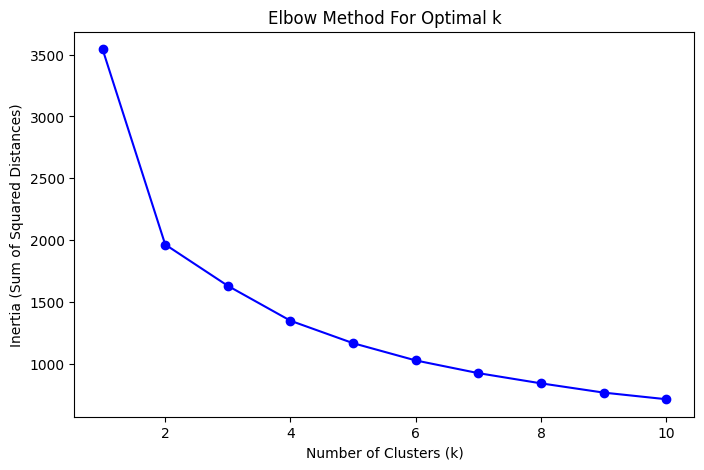

In [43]:
def plot_elbow_method(data, max_clusters=10):
    inertia = []

    for k in range(1, max_clusters + 1):
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        inertia.append(kmeans.inertia_)

    plt.figure(figsize=(8, 5))
    plt.plot(range(1, max_clusters + 1), inertia, 'bo-')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Inertia (Sum of Squared Distances)')
    plt.title('Elbow Method For Optimal k')
    plt.show()

plot_elbow_method(X_train, max_clusters=10)

In [44]:
kmeans = KMeans(n_clusters=4, random_state=42)
kmeans.fit(X_train)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(n_clusters=4, random_state=42)

In [46]:
labels = kmeans.labels_

# Evaluate the Model

In [45]:
silhouette_avg = silhouette_score(X_train, kmeans.labels_)
print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.3494425310827208


# Plot the data points with their predicted cluster center

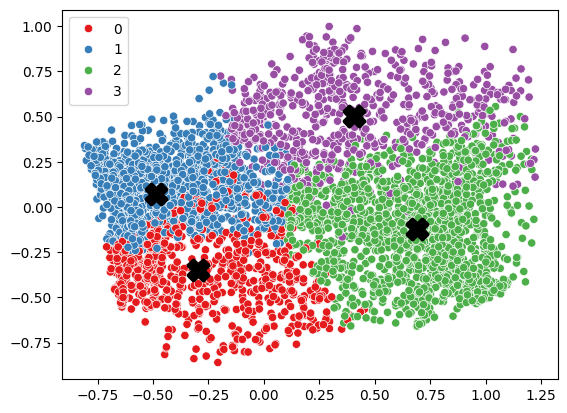

In [47]:
sns.scatterplot(x=X_train[:, 0], y=X_train[:, 1], hue=labels, palette='Set1')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], marker='X', s=200, linewidths=3, color='black')

# Second model


In [48]:
X_train, X_test, y_train, y_test = train_test_split(df_no_outliers_IQR.drop('TENURE', axis=1), df_no_outliers_IQR['TENURE'], test_size=0.2, random_state=0)

In [49]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [50]:
pca = PCA(n_components=0.9)
X_train = pca.fit_transform(X_train)
X_test = pca.transform(X_test)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

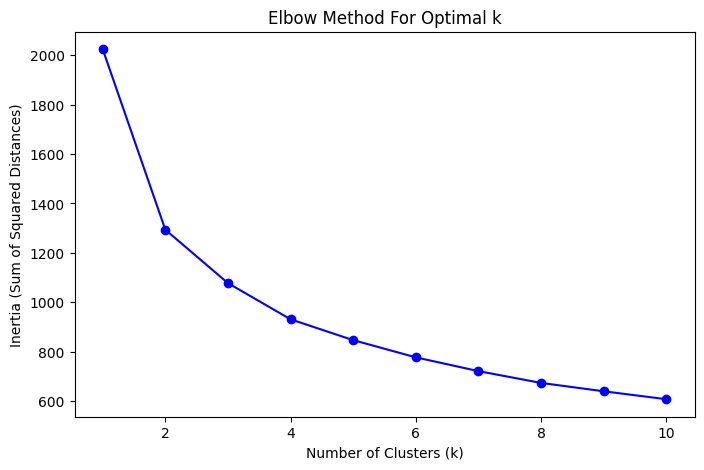

In [51]:
def plot_elbow_method(data, max_clusters=10):
    inertia = []

    for k in range(1, max_clusters + 1):
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        inertia.append(kmeans.inertia_)

    plt.figure(figsize=(8, 5))
    plt.plot(range(1, max_clusters + 1), inertia, 'bo-')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Inertia (Sum of Squared Distances)')
    plt.title('Elbow Method For Optimal k')
    plt.show()

plot_elbow_method(X_train, max_clusters=10)

In [52]:
kmeans = KMeans(n_clusters=4, random_state=42)
kmeans.fit(X_train)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(n_clusters=4, random_state=42)

In [53]:
labels = kmeans.labels_

In [54]:
silhouette_avg = silhouette_score(X_train, kmeans.labels_)
print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.2599265362910696


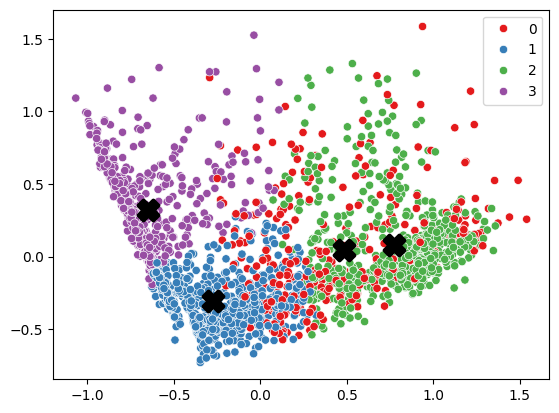

In [55]:
sns.scatterplot(x=X_train[:, 0], y=X_train[:, 1], hue=labels, palette='Set1')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], marker='X', s=200, linewidths=3, color='black')

#Third Model

In [56]:
scaler = MinMaxScaler()
X_train = scaler.fit_transform(df_no_outliers_IF)

In [57]:
pca = PCA(n_components=0.9)
X_train = pca.fit_transform(X_train)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

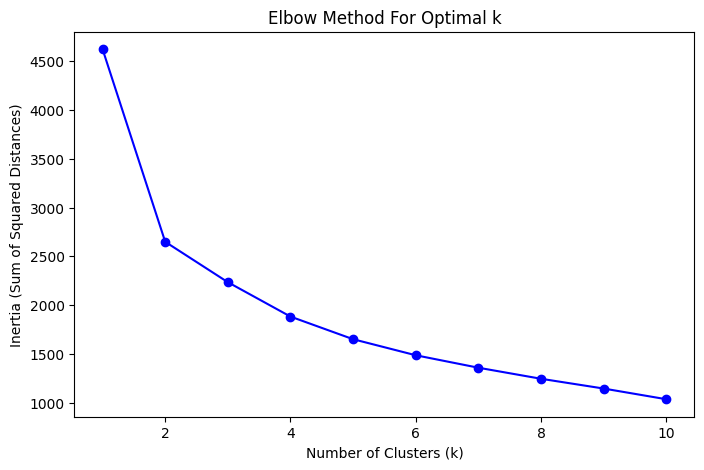

In [58]:
def plot_elbow_method(data, max_clusters=10):
    inertia = []

    for k in range(1, max_clusters + 1):
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        inertia.append(kmeans.inertia_)

    plt.figure(figsize=(8, 5))
    plt.plot(range(1, max_clusters + 1), inertia, 'bo-')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Inertia (Sum of Squared Distances)')
    plt.title('Elbow Method For Optimal k')
    plt.show()

plot_elbow_method(X_train, max_clusters=10)

In [59]:
kmeans = KMeans(n_clusters=4, random_state=42)
kmeans.fit(X_train)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(n_clusters=4, random_state=42)

In [60]:
labels = kmeans.labels_

In [61]:
silhouette_avg = silhouette_score(X_train, kmeans.labels_)
print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.3334993492827317


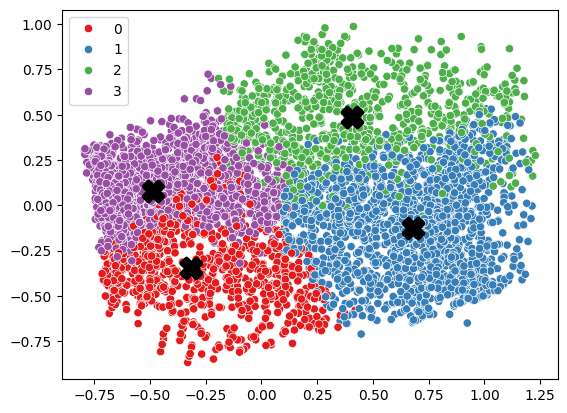

In [62]:
sns.scatterplot(x=X_train[:, 0], y=X_train[:, 1], hue=labels, palette='Set1')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], marker='X', s=200, linewidths=3, color='black')